In [ ]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
from skimage.metrics import structural_similarity as ssim
import numpy as np
import matplotlib.pyplot as plt

# Monte Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Chemins vers les données
train_path = '/content/drive/MyDrive/screw/train/good'
test_path = '/content/drive/MyDrive/screw/test'
ground_truth_path = '/content/drive/MyDrive/screw/ground_truth'

# Fonction pour charger les images et les convertir en niveaux de gris
def load_images(folder, target_size=(256, 256)):
    images = []
    for filename in os.listdir(folder):
        file_path = os.path.join(folder, filename)
        if os.path.isfile(file_path):  # Vérifie si c'est un fichier
            img = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)  # Convertir en niveaux de gris
            if img is not None:
                img = cv2.resize(img, target_size)  # Redimensionner à la taille souhaitée
                images.append(img)
    return np.array(images)

# Fonction pour charger les images de test par sous-dossier, avec tri par nom de fichier
def load_test_images_by_folder(base_test_path, target_size=(256, 256)):
    test_images = {}
    for folder in os.listdir(base_test_path):  # Parcourir les sous-dossiers
        folder_path = os.path.join(base_test_path, folder)
        if os.path.isdir(folder_path):  # Vérifie si c'est un dossier
            # Trier les fichiers dans le dossier par nom de fichier (ordre croissant)
            sorted_image_files = sorted(os.listdir(folder_path))
            # Filtrer les fichiers pour ne garder que les fichiers .png
            sorted_image_files = [f for f in sorted_image_files if f.endswith('.png')]

            sorted_test_images = []
            for image_file in sorted_image_files:
                image_path = os.path.join(folder_path, image_file)
                image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Charger en niveaux de gris
                image_resized = cv2.resize(image, target_size)  # Redimensionner
                image_resized = image_resized / 255.0  # Normaliser entre 0 et 1
                sorted_test_images.append(image_resized)

            # Convertir en tableau numpy avec dimension de canal et type np.float32
            test_images[folder] = np.expand_dims(np.array(sorted_test_images), axis=-1).astype(np.float32)

    return test_images

# Charger les données d'entraînement (images normales uniquement)
train_images = load_images(train_path) / 255.0  # Normaliser entre 0 et 1
train_images = train_images.astype(np.float32)

# Charger les données de test
test_images = load_test_images_by_folder(test_path)

# Charger les masques de vérité terrain
ground_truth_masks = load_test_images_by_folder(ground_truth_path)

# Diviser train_images en 10 % pour la validation et 90 % pour l'entraînement
train_images, val_images = train_test_split(train_images, test_size=0.1, random_state=42)

# Ajouter une dimension de canal à `train_images` et `val_images`
train_images = np.expand_dims(train_images, axis=-1)
val_images = np.expand_dims(val_images, axis=-1)

# Vérification des dimensions des ensembles de données
print("Nombre d'images dans l'ensemble d'entraînement :", train_images.shape)
print("Nombre d'images dans l'ensemble de validation :", val_images.shape)

# Vérification des dossiers de test
for key, value in test_images.items():
    print(f"Dossier '{key}': {value.shape} images chargées.")

# Vérification des dossiers Ground Truth
for key, value in ground_truth_masks.items():
    print(f"Ground truth masks ({key}) shape:", value.shape)


Mounted at /content/drive
Nombre d'images dans l'ensemble d'entraînement : (288, 256, 256, 1)
Nombre d'images dans l'ensemble de validation : (32, 256, 256, 1)
Dossier 'scratch_neck': (25, 256, 256, 1) images chargées.
Dossier 'scratch_head': (24, 256, 256, 1) images chargées.
Dossier 'thread_top': (23, 256, 256, 1) images chargées.
Dossier 'thread_side': (23, 256, 256, 1) images chargées.
Dossier 'manipulated_front': (24, 256, 256, 1) images chargées.
Dossier 'good': (41, 256, 256, 1) images chargées.
Ground truth masks (thread_top) shape: (23, 256, 256, 1)
Ground truth masks (scratch_neck) shape: (25, 256, 256, 1)
Ground truth masks (thread_side) shape: (23, 256, 256, 1)
Ground truth masks (manipulated_front) shape: (24, 256, 256, 1)
Ground truth masks (scratch_head) shape: (24, 256, 256, 1)


In [ ]:
from tensorflow.keras import regularizers
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Définir le modèle d'autoencodeur avec la régularisation L2, Batch Normalization, et Dropout
def build_autoencoder(input_shape, dropout_rate=0.1):
    # Entrée
    input_img = layers.Input(shape=input_shape)

    # Encoder
    x = layers.Conv2D(32, (3, 3), activation='relu', padding='same',
                      kernel_regularizer=regularizers.l2(0.01))(input_img)  # L2 regularization
    x = layers.MaxPooling2D((2, 2), padding='same')(x)
    x = layers.Dropout(dropout_rate)(x)  # Dropout

    x = layers.Conv2D(64, (3, 3), activation='relu', padding='same',
                      kernel_regularizer=regularizers.l2(0.01))(x)  # L2 regularization
    x = layers.MaxPooling2D((2, 2), padding='same')(x)
    x = layers.Dropout(dropout_rate)(x)  # Dropout

    # Decoder
    x = layers.Conv2DTranspose(64, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Dropout(dropout_rate)(x)  # Dropout

    x = layers.Conv2DTranspose(32, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Dropout(dropout_rate)(x)  # Dropout

    decoded = layers.Conv2DTranspose(1, (3, 3), activation='sigmoid', padding='same')(x)  # Sigmoid pour les images en niveaux de gris

    # Créer le modèle
    autoencoder = models.Model(inputs=input_img, outputs=decoded)
    return autoencoder

# Créer et compiler l'autoencodeur avec un learning rate ajusté
autoencoder = build_autoencoder(input_shape=(256, 256, 1))
autoencoder.compile(optimizer=Adam(learning_rate=1e-3), loss='mse')  # Learning rate ajusté

# Définir les callbacks
early_stopping = EarlyStopping(monitor='val_loss',
                               patience=5,
                               restore_best_weights=True,
                               verbose=1)

lr_scheduler = ReduceLROnPlateau(monitor='val_loss',
                                  factor=0.5,
                                  patience=3,
                                  min_lr=1e-6,
                                  verbose=1)

# Entraîner l'autoencodeur avec un batch size de 16
history = autoencoder.fit(train_images,
                          train_images,
                          epochs=50,  # Ajuster le nombre d'époques si nécessaire
                          batch_size=32,  # Ajustement de la taille du batch
                          validation_data=(val_images, val_images),
                          callbacks=[early_stopping, lr_scheduler])


Epoch 1/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 97s 10s/step - loss: 0.4541 - val_loss: 0.3418 - learning_rate: 0.0010
Epoch 2/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 133s 10s/step - loss: 0.3182 - val_loss: 0.2504 - learning_rate: 0.0010
Epoch 3/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 141s 9s/step - loss: 0.2304 - val_loss: 0.1819 - learning_rate: 0.0010
Epoch 4/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 83s 9s/step - loss: 0.1646 - val_loss: 0.1285 - learning_rate: 0.0010
Epoch 5/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 83s 9s/step - loss: 0.1161 - val_loss: 0.0907 - learning_rate: 0.0010
Epoch 6/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 151s 10s/step - loss: 0.0807 - val_loss: 0.0627 - learning_rate: 0.0010
Epoch 7/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 133s 9s/step - loss: 0.0541 - val_loss: 0.0454 - learning_rate: 0.0010
Epoch 8/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 143s 9s/step - loss: 0.0375 - val_loss: 0.0325 - learning_rate: 0.0010
Epoch 9/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 143s 9s/step - loss: 0.0273 - val_loss: 0.0263 - learning_rate: 0.0010
Epoch 10/50
9/9 ━━━━━━━━━━━━━━━━━━━━ 

In [ ]:
# Save the model after training
autoencoder.save('/content/drive/MyDrive/autoencoder_model2.keras')
print("Le modèle a été sauvegardé.")

#from tensorflow.keras.models import load_model

# Charger le modèle depuis le fichier
#autoencoder = load_model('/content/drive/MyDrive/autoencoder_model2.keras')

#print("Le modèle a été chargé avec succès.")


Le modèle a été sauvegardé.


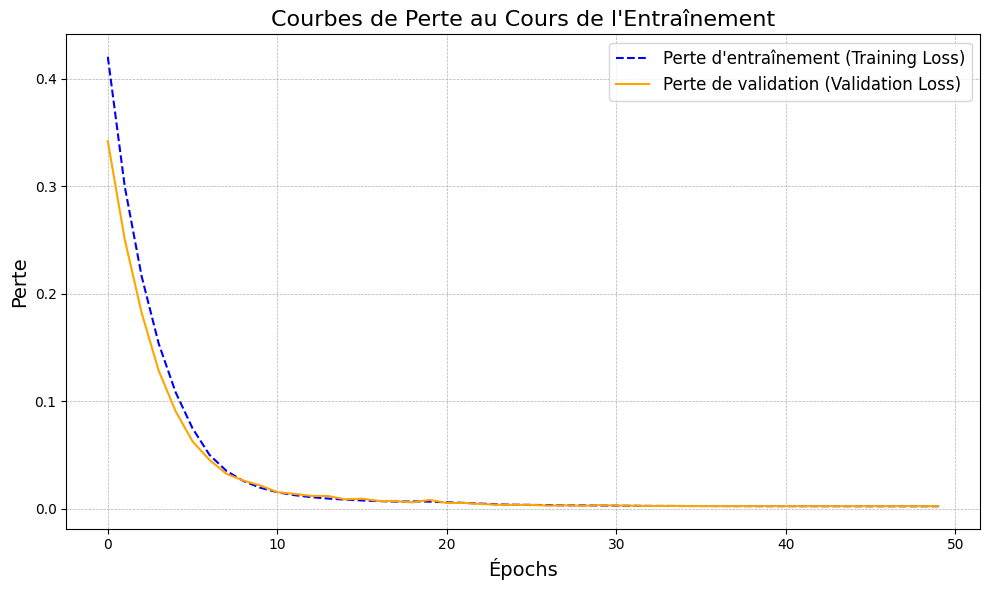

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Supposons que 'history' soit l'objet renvoyé par model.fit()
plt.figure(figsize=(10, 6))

# Courbes de perte
plt.plot(history.history['loss'], label='Perte d\'entraînement (Training Loss)', color='blue', linestyle='--')
plt.plot(history.history['val_loss'], label='Perte de validation (Validation Loss)', color='orange', linestyle='-')

# Titre et légendes
plt.title('Courbes de Perte au Cours de l\'Entraînement', fontsize=16)
plt.xlabel('Épochs', fontsize=14)
plt.ylabel('Perte', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

# Affichage
plt.tight_layout()
plt.show()


Traitement des prédictions pour le dossier: scratch_neck
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
Dossier: scratch_neck
	Image 1 - MSE: 0.00098046, MAE: 0.02375311
	Image 2 - MSE: 0.00111341, MAE: 0.02585419
	Image 3 - MSE: 0.00122087, MAE: 0.02664662
	Image 4 - MSE: 0.00133731, MAE: 0.02753643
	Image 5 - MSE: 0.00125913, MAE: 0.02782366
	Image 6 - MSE: 0.00121108, MAE: 0.02749921
	Image 7 - MSE: 0.00134312, MAE: 0.02844958
	Image 8 - MSE: 0.00136496, MAE: 0.02831890
	Image 9 - MSE: 0.00128229, MAE: 0.02815148
	Image 10 - MSE: 0.00120774, MAE: 0.02743185
	Image 11 - MSE: 0.00126416, MAE: 0.02752881
	Image 12 - MSE: 0.00128952, MAE: 0.02770054
	Image 13 - MSE: 0.00114206, MAE: 0.02601576
	Image 14 - MSE: 0.00143265, MAE: 0.02886237
	Image 15 - MSE: 0.00128305, MAE: 0.02774683
	Image 16 - MSE: 0.00139604, MAE: 0.02839707
	Image 17 - MSE: 0.00139111, MAE: 0.02846876
	Image 18 - MSE: 0.00122597, MAE: 0.02672982
	Image 19 - MSE: 0.00117341, MAE: 0.02629861
	Image 20 - MSE: 0.00127751, MAE: 0.027

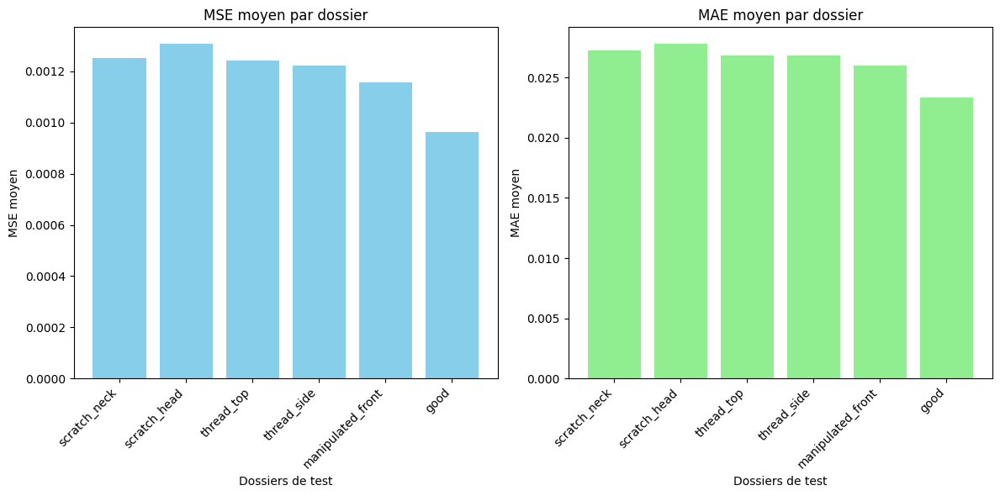

In [ ]:
# Initialisation des dictionnaires pour stocker les erreurs par sous-dossier
mse_errors_by_folder = {}
mae_errors_by_folder = {}

# Initialisation des listes pour stocker toutes les erreurs MSE et MAE globales
all_mse_errors = []
all_mae_errors = []

# Prédictions et calcul des erreurs pour chaque sous-dossier
for folder_name, test_images_in_folder in test_images.items():
    print(f"Traitement des prédictions pour le dossier: {folder_name}")

    # Prédire les images reconstruites
    reconstructed_images = autoencoder.predict(test_images_in_folder)

    # Calcul des erreurs de reconstruction
    mse_errors = np.mean(np.square(test_images_in_folder - reconstructed_images), axis=(1, 2, 3))
    mae_errors = np.mean(np.abs(test_images_in_folder - reconstructed_images), axis=(1, 2, 3))

    # Stockage des erreurs dans les dictionnaires par dossier
    mse_errors_by_folder[folder_name] = mse_errors
    mae_errors_by_folder[folder_name] = mae_errors

    # Afficher les erreurs pour chaque image dans le dossier
    print(f"Dossier: {folder_name}")
    for i in range(len(mse_errors)):
        print(f"\tImage {i+1} - MSE: {mse_errors[i]:.8f}, MAE: {mae_errors[i]:.8f}")

    # Ajouter toutes les erreurs MSE et MAE dans les listes globales
    all_mse_errors.extend(mse_errors)
    all_mae_errors.extend(mae_errors)

# Calcul des statistiques pour toutes les erreurs globales
mean_error = np.mean(all_mse_errors)  # Moyenne de toutes les erreurs MSE
std_error = np.std(all_mse_errors)    # Écart-type de toutes les erreurs MSE
mean_errormae = np.mean(all_mae_errors)  # Moyenne de toutes les erreurs MAE
std_errormae = np.std(all_mae_errors)    # Écart-type de toutes les erreurs MAE

# Calcul du seuil basé sur une règle statistique (ex. : 2 écarts-types)
threshold = mean_error + 2 * std_error
print(f"Seuil recommandé pour tous les dossiers: {threshold:.8f}")

# Imprimer les statistiques globales pour tous les dossiers
print(f"Moyenne de l'erreur MSE pour tous les dossiers: moyenne = {mean_error:.8f}, écart-type = {std_error:.8f}")
print(f"Moyenne de l'erreur MAE pour tous les dossiers: moyenne = {mean_errormae:.8f}, écart-type = {std_errormae:.8f}")

# Visualisation des erreurs par dossier
folders = list(mse_errors_by_folder.keys())
mse_means = [np.mean(mse_errors_by_folder[folder]) for folder in folders]
mae_means = [np.mean(mae_errors_by_folder[folder]) for folder in folders]

plt.figure(figsize=(12, 6))

# MSE
plt.subplot(1, 2, 1)
plt.bar(folders, mse_means, color='skyblue')
plt.title('MSE moyen par dossier')
plt.xlabel('Dossiers de test')
plt.ylabel('MSE moyen')
plt.xticks(rotation=45, ha='right')

# MAE
plt.subplot(1, 2, 2)
plt.bar(folders, mae_means, color='lightgreen')
plt.title('MAE moyen par dossier')
plt.xlabel('Dossiers de test')
plt.ylabel('MAE moyen')
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()


Traitement des anomalies pour le dossier : scratch_neck
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Dimensions des images reconstruites : (25, 256, 256, 1)
Dossier : scratch_neck
Anomalies détectées (MSE > 0.0011) : 24 / 25
Affichage de 24 anomalies détectées pour le dossier : scratch_neck


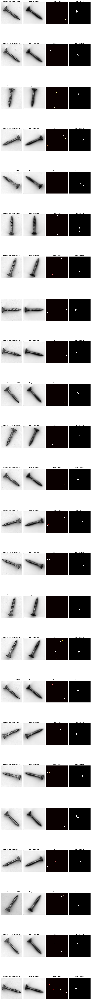

Traitement des anomalies pour le dossier : scratch_head
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Dimensions des images reconstruites : (24, 256, 256, 1)
Dossier : scratch_head
Anomalies détectées (MSE > 0.0011) : 24 / 24
Affichage de 24 anomalies détectées pour le dossier : scratch_head


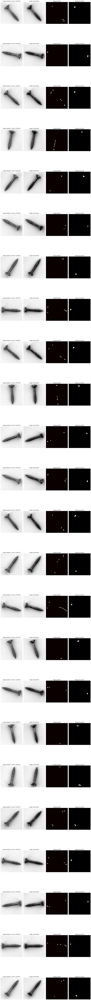

Traitement des anomalies pour le dossier : thread_top
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Dimensions des images reconstruites : (23, 256, 256, 1)
Dossier : thread_top
Anomalies détectées (MSE > 0.0011) : 23 / 23
Affichage de 23 anomalies détectées pour le dossier : thread_top


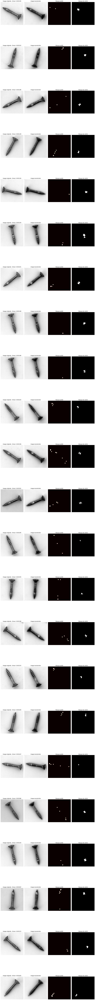

Traitement des anomalies pour le dossier : thread_side
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Dimensions des images reconstruites : (23, 256, 256, 1)
Dossier : thread_side
Anomalies détectées (MSE > 0.0011) : 22 / 23
Affichage de 22 anomalies détectées pour le dossier : thread_side


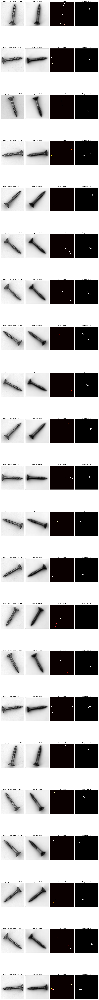

Traitement des anomalies pour le dossier : manipulated_front
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Dimensions des images reconstruites : (24, 256, 256, 1)
Dossier : manipulated_front
Anomalies détectées (MSE > 0.0011) : 17 / 24
Affichage de 17 anomalies détectées pour le dossier : manipulated_front


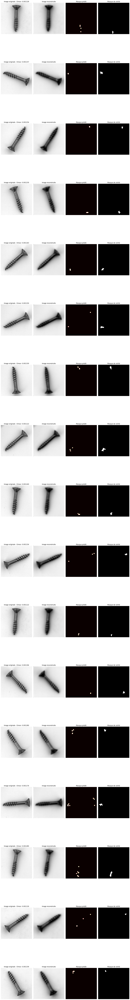

Traitement des anomalies pour le dossier : good
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step
Dimensions des images reconstruites : (41, 256, 256, 1)
Dossier : good
Anomalies détectées (MSE > 0.0011) : 0 / 41
Aucune anomalie détectée pour le dossier : good


In [ ]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Définir un seuil MSE pour détecter les anomalies
threshold_mse = 0.0011  # Ajustez en fonction des observations

# Définir un seuil pour générer des masques prédits
mask_threshold = 0.29  # Ajustez selon la différence attendue entre les images originales et reconstruites

# Boucle pour traiter chaque dossier
for folder_name, test_images_in_folder in test_images.items():
    print(f"Traitement des anomalies pour le dossier : {folder_name}")

    # Trier les images dans le dossier de test par nom de fichier (ordre croissant)
    sorted_image_files = sorted(os.listdir(os.path.join(test_path, folder_name)))

    # Filtrer les fichiers pour ne garder que les fichiers .png
    sorted_image_files = [f for f in sorted_image_files if f.endswith('.png')]

    # Charger les images dans l'ordre trié et redimensionner
    sorted_test_images = []
    for image_file in sorted_image_files:
        image_path = os.path.join(test_path, folder_name, image_file)
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Charger l'image en niveaux de gris
        image_resized = cv2.resize(image, (256, 256))  # Redimensionner à la taille attendue
        image_resized = image_resized / 255.0  # Normaliser les images entre 0 et 1
        sorted_test_images.append(image_resized)

    # Convertir en tableau numpy pour la prédiction
    sorted_test_images = np.expand_dims(np.array(sorted_test_images), axis=-1)  # Ajouter une dimension pour les canaux

    # Prédire les images reconstruites
    reconstructed_images = autoencoder.predict(sorted_test_images)

    # Vérification des dimensions des images reconstruites
    print(f"Dimensions des images reconstruites : {reconstructed_images.shape}")

    # Calcul des erreurs de reconstruction pour chaque image
    mse_errors = np.mean(np.square(sorted_test_images - reconstructed_images), axis=(1, 2, 3))
    anomalies_detected = mse_errors > threshold_mse

    # Résumé des anomalies détectées
    print(f"Dossier : {folder_name}")
    print(f"Anomalies détectées (MSE > {threshold_mse}) : {np.sum(anomalies_detected)} / {len(mse_errors)}")

    # Listes pour stocker les images et masques détectés comme anomalies
    anomaly_images = []
    reconstructed_anomaly_images = []
    predicted_masks = []
    anomaly_masks = []

    # Indices des anomalies détectées
    anomalous_indices = np.where(anomalies_detected)[0]

    # Parcourir uniquement les indices détectés comme anomalies
    for idx in anomalous_indices:
        # Construire les chemins des fichiers pour l'image et le masque
        image_filename = sorted_image_files[idx]  # Nom du fichier image trié
        mask_filename = f"{idx:03d}_mask.png"  # Format 000_mask.png, 001_mask.png, ...
        image_path = os.path.join(test_path, folder_name, image_filename)
        mask_path = os.path.join(ground_truth_path, folder_name, mask_filename)

        # Générer le masque d'anomalie basé sur la différence de reconstruction
        difference = np.abs(sorted_test_images[idx].squeeze() - reconstructed_images[idx].squeeze())

        # Appliquer un seuil pour identifier les anomalies
        predicted_mask = (difference > mask_threshold).astype(np.uint8) * 255

        # Optionnel : Utilisation de l'algorithme de détection de contours pour mieux localiser les anomalies
        edges = cv2.Canny(predicted_mask, threshold1=100, threshold2=200)

        # Vous pouvez également ajuster le masque avec un filtre (par exemple, dilation ou érosion) pour affiner les résultats
        predicted_mask_dilated = cv2.dilate(edges, None, iterations=2)

        # Ajouter aux listes pour affichage
        anomaly_images.append(sorted_test_images[idx])
        reconstructed_anomaly_images.append(reconstructed_images[idx])
        predicted_masks.append(predicted_mask_dilated)

        # Vérifier si le masque de vérité existe
        if os.path.exists(mask_path):
            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            anomaly_masks.append(mask)

    # Afficher toutes les anomalies détectées pour le dossier courant
    num_anomalies = len(anomaly_images)
    if num_anomalies > 0:
        print(f"Affichage de {num_anomalies} anomalies détectées pour le dossier : {folder_name}")

        # Créer une figure pour afficher toutes les anomalies détectées
        plt.figure(figsize=(15, 7 * num_anomalies))

        for idx in range(num_anomalies):
            # Affichage de l'image originale
            plt.subplot(num_anomalies, 4, idx * 4 + 1)
            plt.imshow(anomaly_images[idx].squeeze(), cmap='gray')
            plt.title(f"Image originale - Erreur: {mse_errors[anomalous_indices[idx]]:.6f}")
            plt.axis('off')

            # Affichage de l'image reconstruite
            plt.subplot(num_anomalies, 4, idx * 4 + 2)
            plt.imshow(reconstructed_anomaly_images[idx].squeeze(), cmap='gray')
            plt.title("Image reconstruite")
            plt.axis('off')

            # Affichage du masque prédit
            plt.subplot(num_anomalies, 4, idx * 4 + 3)
            plt.imshow(predicted_masks[idx], cmap='hot')
            plt.title("Masque prédit")
            plt.axis('off')

            # Affichage du masque de vérité si disponible
            plt.subplot(num_anomalies, 4, idx * 4 + 4)
            if idx < len(anomaly_masks):
                plt.imshow(anomaly_masks[idx], cmap='gray')
                plt.title("Masque de vérité")
            else:
                plt.title("Masque de vérité non disponible")
            plt.axis('off')

        plt.tight_layout()
        plt.show()
    else:
        print(f"Aucune anomalie détectée pour le dossier : {folder_name}")
